# Rapport data challenge - Arnaud AILLAUD

## 1. Abstract

Ce data challenge consiste en une tâche de classification binaire d'images de visage. Les deux seules subtilités de ce challenge sont :
* Description des labels attribués aux images non explicite : les labels sont seulement `1` et `-1` (substitué par `0` dans le code utilisé). Entraîner un réseau de neurones sans savoir ce qu'il doit classifier n'est en soit absolument pas gênant, mais l'absence d'informations sur les différentes classes limite les techniques d'augmentation de données (par peur de détruire de l'information utile dans les images). Cela complique également l'utilisation de modèles multimodaux tels que CLIP, qui fonctionnent sur la base de prompts en language naturels.
* Métrique d'évaluation faisant intervenir la différence de précision de classification entre hommes et femmes :
$$ mean(accuracy_{men}, accuracy_{women}) - abs(accuracy_{men} - accuracy_{women})$$ Un algorithme non biaisé est donc privilégié par rapport à un algorithme performant

La classification d'images étant une tâche basique en traitement d'images, de nombreux modèles adressant cette tâche sont disponibles en ligne avec leurs poids d'entraînement. J'ai obtenu le score de **0.912876295259** avec la configuration suivante :
> * Finetuning complet d'un modèle **DINO** [[article](https://arxiv.org/abs/2104.14294)][[code](https://github.com/facebookresearch/dino/tree/main)] préentraîné sur ImageNet-1k
>  * Version small : 21 M de paramètres
>  * Patchs de taille 8 x 8px
>  * Poids d'entraînement récupérés sur huggingface : [facebook/dino-vits8](https://huggingface.co/facebook/dino-vits8)
> * Optimizer **SING** [[article](https://arxiv.org/abs/2305.15997)][[code](https://github.com/AdrienCourtois/SING/tree/main)] avec
>  * Learning rate initial : $5\times 10^{-4}$
>  * Weight decay : $5\times 10^{-3}$
> * Scheduler **cosinus**, avec warmup sur 5% des steps
> * Batch size de taille 64
> * Early stopping à 8 epochs

## 2. Exploration initiale des données

Avant de se lancer dans l'implémentation d'un modèle, il est toujours utile d'explorer un minimum les données à traiter

In [50]:
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd 
from PIL import Image
from scipy.signal import savgol_filter
import glob

In [2]:
labels = pd.read_csv('./data_challenge_Avril_2023/train.txt', sep = '\t', header = None, names = ['image','label', 'genre'])
labels['label'] = labels['label'].map(lambda x: 0 if x == -1 else x)
labels.head()

,image,label,genre
0,000000.jpg,0,-1
1,000001.jpg,1,-1
2,000002.jpg,0,-1
3,000003.jpg,0,1
4,000004.jpg,1,1


### 2.1. Caractéristiques du dataset

Le dataset fait intervenir 2 classes, et la métrique d'évaluation prend en compte le genre des personnes photographiées (homme ou femme). Le graphe ci-dessous permet de visualiser la répartition du dataset en fonction de ces 2 caractéristiques.

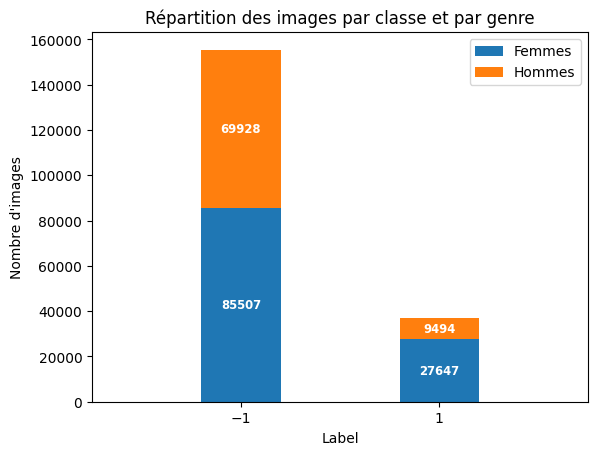

In [3]:
df = labels.groupby(['label', 'genre'], as_index=False).size()
fig, ax = plt.subplots()  
ax.bar(-1, df.iloc[0]['size'], label="Femmes")
ax.bar(-1, df.iloc[1]['size'], bottom=df.iloc[0]['size'], label="Hommes")
ax.bar(1, df.iloc[2]['size'], color="C0")
ax.bar(1, df.iloc[3]['size'], bottom= df.iloc[2]['size'], color="C1")
ax.set_xticks([-1, 1])
ax.set_xlim(-2.5, 2.5)
for bars in ax.containers:
    ax.bar_label(bars, label_type='center', color='white', fontweight='bold', fontsize="smaller")
plt.ylabel("Nombre d'images")
plt.xlabel("Label")
plt.title("Répartition des images par classe et par genre")
plt.legend()
plt.show()

Le jeu de données est donc **extrêmement déséquilibré, tant au niveau de la répartition des classes que de la répartition des genres**. A première vue, il semble difficile d'apprendre une bonne représentation de la classe 1 pour les hommes ($\sim$5% du jeu de données total, comparés aux 44% représentés par les femmes de la classe 0).

### 2.2. Hypothèses sur les labels

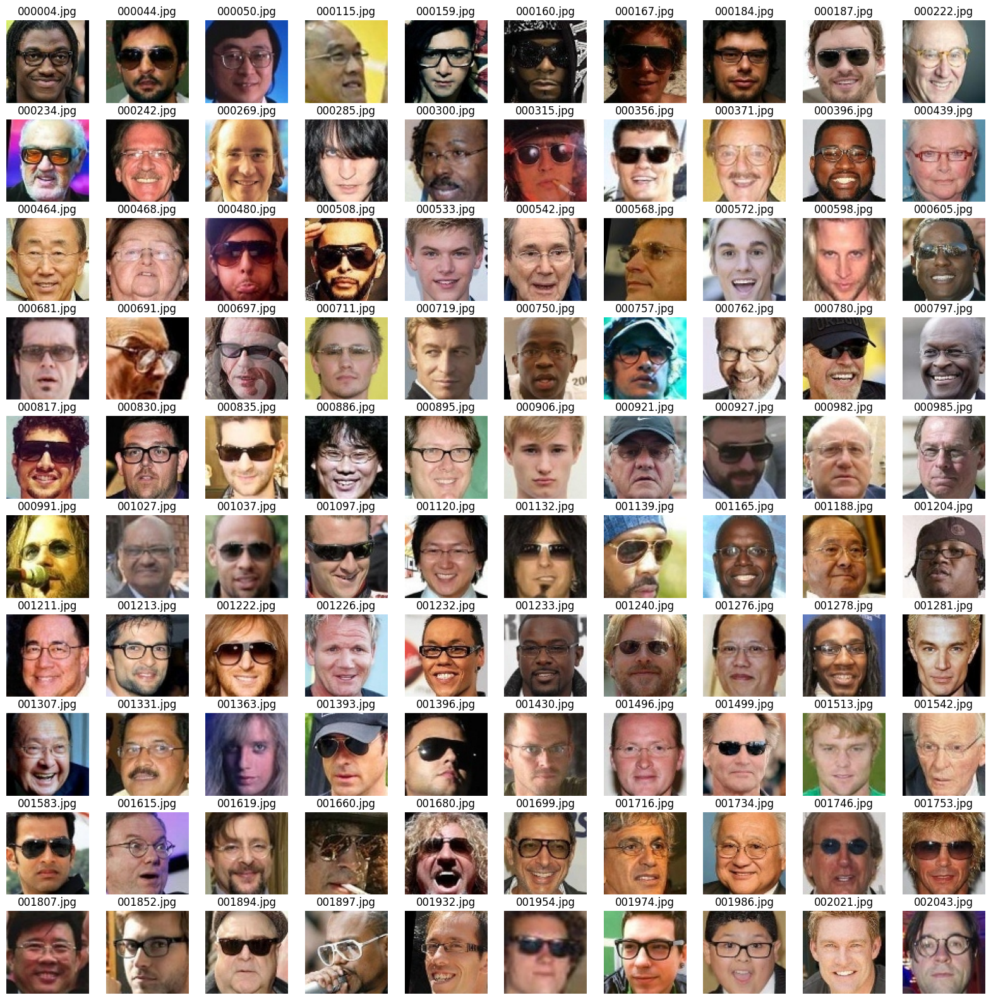

In [4]:
# Affichage des 100 premières images d'homme de la classe 1
plt.figure(figsize=(20, 20))
for i,idx in enumerate(labels[(labels['label'] == 1) & (labels['genre'] == 1)]['image'][:100]):
    img = Image.open(f"./data_challenge_Avril_2023/train/{idx}")
    ax = plt.subplot(10, 10, i + 1)
    plt.imshow(img)
    ax.set_title(idx)
    ax.axis('off')

On remarque que la majorité des hommes de la classe 1 portent des lunettes. La majorité des hommes sans lunette sont blonds, la couleur des cheveux doit donc être un facteur important.

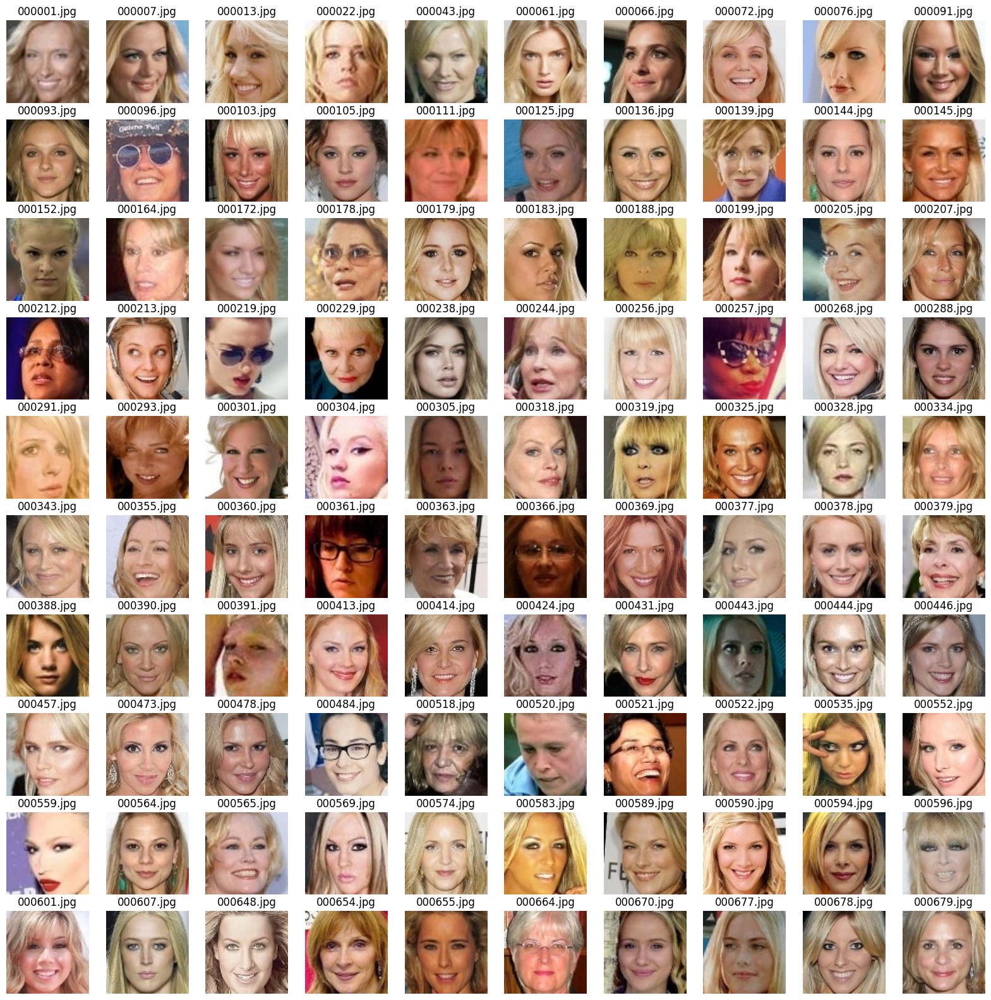

In [5]:
# Affichage des 100 premières images de femme de la classe 1
plt.figure(figsize=(20, 20))
for i,idx in enumerate(labels[(labels['label'] == 1) & (labels['genre'] == -1)]['image'][:100]):
    img = Image.open(f"./data_challenge_Avril_2023/train/{idx}")
    ax = plt.subplot(10, 10, i + 1)
    plt.imshow(img)
    ax.set_title(idx)
    ax.axis('off')

Pour les femmes, la majorité des photos de la classe 1 sont des photos de femmes blondes, ainsi que de femmes avec des lunettes. Cela est cohérent avec les observations réalisées pour les hommes.

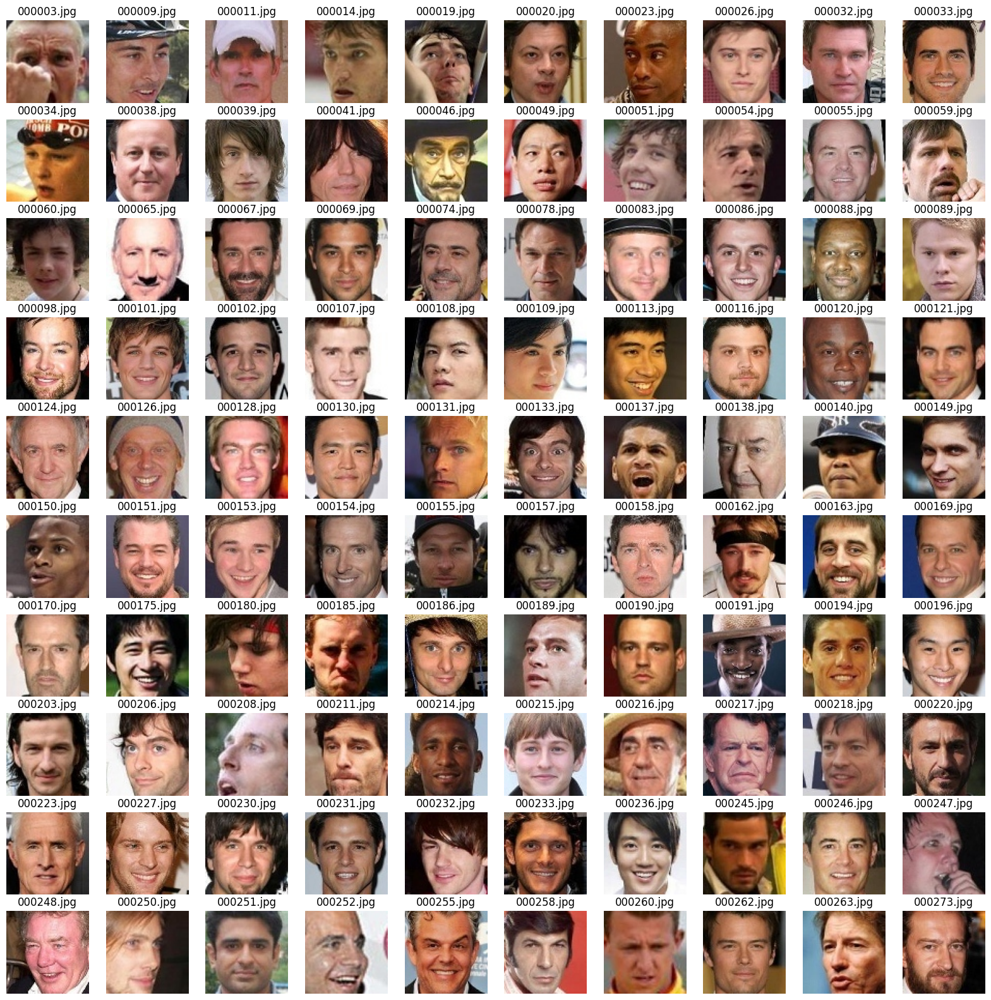

In [6]:
# Affichage des 100 premières images d'homme de label -1
plt.figure(figsize=(20, 20))
for i,idx in enumerate(labels[(labels['label'] == 0) & (labels['genre'] == 1)]['image'][:100]):
    img = Image.open(f"./data_challenge_Avril_2023/train/{idx}")
    ax = plt.subplot(10, 10, i + 1)
    plt.imshow(img)
    ax.set_title(idx)
    ax.axis('off')

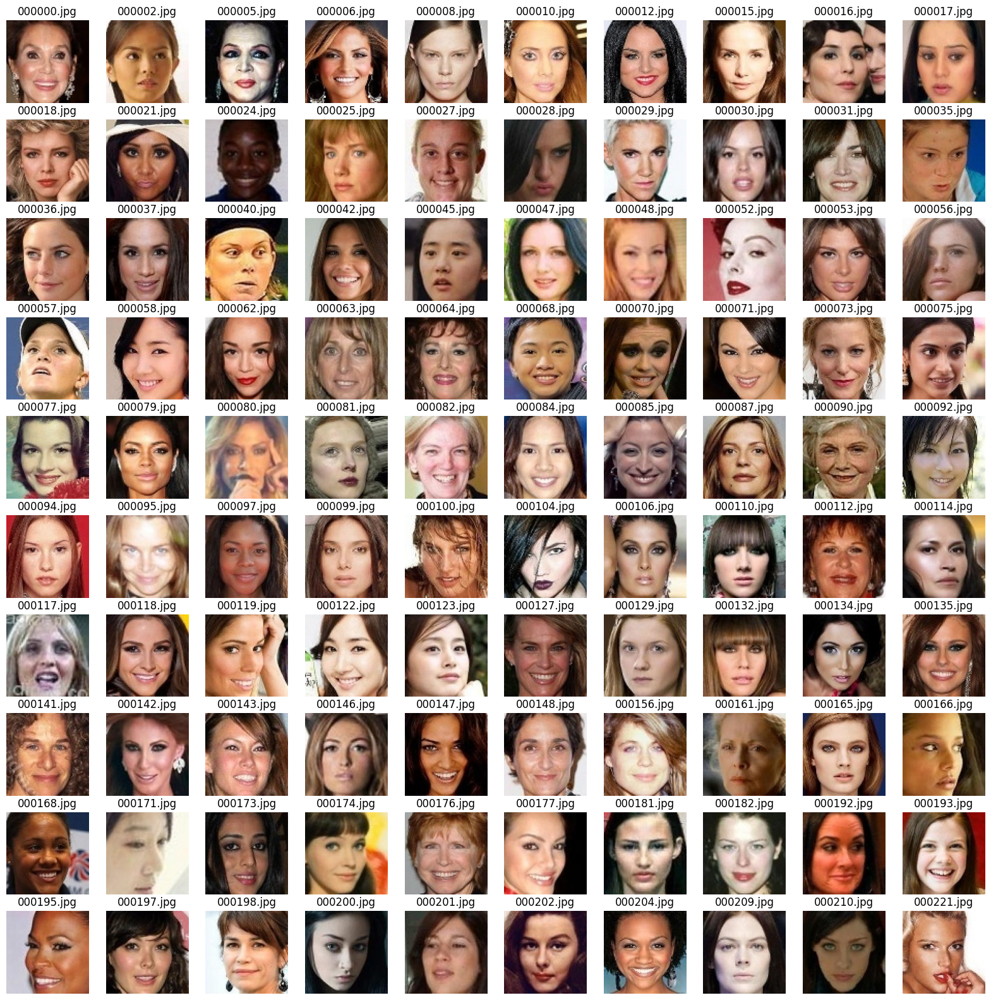

In [7]:
# Affichage des 100 premières images de femme de label -1
plt.figure(figsize=(20, 20))
for i,idx in enumerate(labels[(labels['label'] == 0) & (labels['genre'] == -1)]['image'][:100]):
    img = Image.open(f"./data_challenge_Avril_2023/train/{idx}")
    ax = plt.subplot(10, 10, i + 1)
    plt.imshow(img)
    ax.set_title(idx)
    ax.axis('off')

Certaines personnes blondes sont présentes parmi les personnes de classe -1 (images 18, 25, 73, 80, 87, 117, etc.), mais il ne semble pas y avoir de personnes avec des lunettes dans cette classe. Cette classe semble plus difficile à définir autrement que par opposition à la classe 1.

De ces observations, on peut tirer 2 premiers constats :
* La présence de **lunettes** sur l'image semble être un **critère robuste d'appartenance à la classe 1**
* Il y a une **forte corrélation entre couleurs de cheveux et classe d'appartenance**, les personnes de la classe 1 étant en grande partie blondes. Ce critère n'est pas suffisant à lui-seul pour définir les personnes d'une des 2 classes, mais il incite néanmoins à la prudence quant à l'utilisation de techniques d'augmentation de données modifiant la couleurs des images (risque de modification de la couleur des cheveux et donc d'un important critère de décision)

### 2.3. Jeu de test

Une observation rapide des images de test fait ressortir un certain nombre d'anomalies

<u>Images pivotées</u>

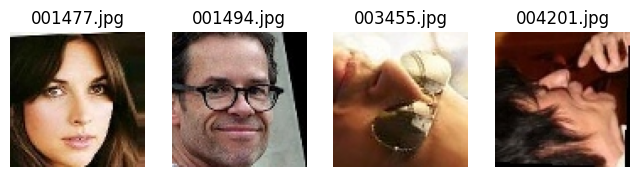

In [8]:
plt.figure(figsize=(8, 4))
for i, idx in enumerate([1477, 1494, 3455, 4201]):
    img = Image.open(f"./data_challenge_Avril_2023/test/{idx:06}.jpg")
    ax = plt.subplot(1, 4, i + 1)
    plt.imshow(img)
    ax.set_title(f"{idx:06}.jpg")
    ax.axis('off')

<u>Images avec luminosité altérée</u>

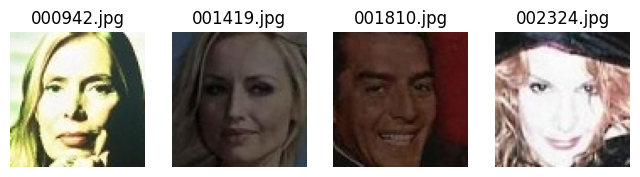

In [9]:
plt.figure(figsize=(8, 4))
for i, idx in enumerate([942, 1419, 1810, 2324]):
    img = Image.open(f"./data_challenge_Avril_2023/test/{idx:06}.jpg")
    ax = plt.subplot(1, 4, i + 1)
    plt.imshow(img)
    ax.set_title(f"{idx:06}.jpg")
    ax.axis('off')

<u>Images floues ou pixelisées</u>

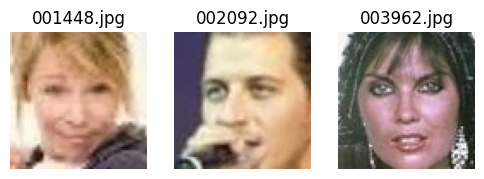

In [10]:
plt.figure(figsize=(6, 4))
for i, idx in enumerate([1448, 2092, 3962]):
    img = Image.open(f"./data_challenge_Avril_2023/test/{idx:06}.jpg")
    ax = plt.subplot(1, 3, i + 1)
    plt.imshow(img)
    ax.set_title(f"{idx:06}.jpg")
    ax.axis('off')

<u>Images déformées</u>

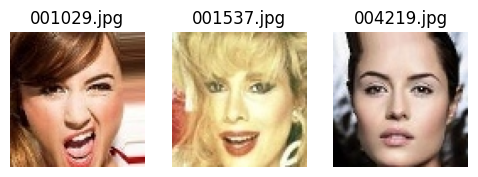

In [11]:
plt.figure(figsize=(8, 4))
for i, idx in enumerate([1029, 1537, 4219]):
    img = Image.open(f"./data_challenge_Avril_2023/test/{idx:06}.jpg")
    ax = plt.subplot(1, 4, i + 1)
    plt.imshow(img)
    ax.set_title(f"{idx:06}.jpg")
    ax.axis('off')

<u>Images cropées / centrée sur sous-partie du visage</u>

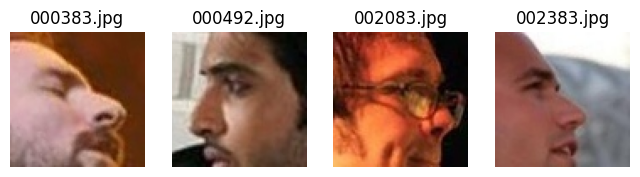

In [12]:
plt.figure(figsize=(8, 4))
for i, idx in enumerate([383, 492, 2083, 2383]):
    img = Image.open(f"./data_challenge_Avril_2023/test/{idx:06}.jpg")
    ax = plt.subplot(1, 4, i + 1)
    plt.imshow(img)
    ax.set_title(f"{idx:06}.jpg")
    ax.axis('off')

Ces informations sont précieuses, car elles permettent d'identifier un certain nombre de techniques d'augmentation de données qui pourront non seulement aider à améliorer le score sur le jeu de test, mais également à généraliser sans détruire d'information de classe.

## 3. Méthodologie

Les modèles de classification les plus performants sur ImageNet sont pour la plupart basés sur des transformers visuels (ViT), ou modèles multimodaux intégrant des ViT, tels que CLIP ou Align. J'ai décidé de profiter du data challenge pour tester ce type de modèles, dont de nombreux poids d'entraînements sont disponibles dans des librairies telles que `transformer` de HuggingFace ou `timm`. <br>
En finetunant un ViT, version de base, patchs de taille 16x16 ([google/vit-base-patch16-224](https://huggingface.co/google/vit-base-patch16-224)) avec entraînement réalisé sur 80% du jeu d'entraînement et 20% gardés en jeu de validation,j'ai obtenu des scores de précision relativement élevés sur le jeu de validation (environ 0.93 pour les femmes et 0.98 pour les hommes). J'ai donc d'abord cherché à réduire l'écart de précision entre les deux genres. Cependant, après une première soumission, j'ai réalisé que la tendance s'inversait sur le jeu de test : le score de précision obtenu pour les femmes était proche de 0.94 alors que celui obtenu pour les hommes était proche de 0.91. Chercher à améliorer la parité sur le jeu d'entraînement s'avérait donc une tâche vaine, puisque la distribution du jeu de test est différente de celle du jeu d'entraînement (les performances de détection des hommes doivent être améliorées sur le jeu de test et non réduites comme les résultats sur le jeu d'entraînement pourraient le faire penser). Etant donné la répartition des données observée dans la section 2.1., cet écart de distribution est probablement dû à une grande présence d'hommes de la classe 1 dans le jeu de test <br>
J'ai tenté de nombreuses approches vaines avant de finalement me résigner à simplement maximiser la précision sur le jeu de validation en espérant que cela maximise également la précision sur le jeu de test. Je n'ai pas trouvé d'approche permettant une augmentation systématique du score, une augmentation du score sur le jeu de validation n'étant pas nécessairement corrélée à une augmentation du score sur le jeu de test.

<u>Liste non exhaustive d'approches testées</u> :
* Utilisation de la [Focal Loss](https://arxiv.org/abs/1708.02002) à la place d'une Cross Entropy Loss, censée améliorer la classification dans le cadre de jeu de données déséquilibrés, mais donne de moins bons scores en pratique
* Ajout d'une pénalité dans la cross entropy loss sur les prédictions du genre "homme" pour tenter d'améliorer le score de précision de ce genre sur le jeu de test
* Suréchantillonage de la catégorie minoritaire (homme de classe 1) pendant l'entraînemenet
* Utilisation de modèles de SSL préentraînés pour travailler avec de meilleurs features : tests de modèles [Masked Auto-encodeur](https://arxiv.org/abs/2111.06377), [t-Rex](https://arxiv.org/abs/2206.15369)
* Autres architectures de basées sur les ViT : [Swin v2](https://arxiv.org/abs/2111.09883) et [FocalNet](https://arxiv.org/abs/2203.11926)
* CLIP à partir de 40 prompts générés à partir des classes du dataset CelebA (forme du visage, couleur des cheveux, présence de lunettes, etc.) et prompt tuning

Les meilleurs scores ont finalement été obtenus avec DINO.

## 4. Implémentation du meilleur modèle

### 4.1. Data Augmentation

J'ai utilisé la librairie [FFCV-SSL](https://github.com/facebookresearch/FFCV-SSL), fork réalisé par Facebook  de la librairie [FFCV](https://ffcv.io/) pour réaliser le chargement des données. La librairie FFCV a pour but d'accélérer l'entraînement de modèles de deep learning en réduisant les goulots d'étranglement liés aux acès disque (notamment grâce à l'utilisaiton d'un format de stockage différent, `.beton`, et la compilation JIT des opérations d'augmentation de données). La librairie développée par Facebook est destinée à êre utilisée dans le cadre de Self Supervised Learning, et intègre donc un plus grand nombre de techniques d'augmentation de données.<br>
Etant donné les images observées sur le jeu de test, j'ai choisi d'implémenter les augmentations de données suivantes :
* RandomResizeCrop en changeant la taille minimale de crop à 50% de l'image initiale,
* RandomHorizontalFlip() avec les paramètres par défaut (probabilité de modification de 50%),
* Rotate(angle=0.5) (la valeur d'angle n'est pas en degré, et correspond à des petits angles ~10/15°),
* RandomErasing(erase_prob=0.5, scale=(0.02, 0.4), ratio=(0.15, 6), mean=eraser_mean) qui efface des rectangles de taille variable sur l'image,
* RandomColorJitter(jitter_prob=0.5, brightness=[1.0, 1.5], contrast=0, saturation=[1.0, 1.5], hue=0) configuré uniquement pour ne modifier que la luminosité et la saturation, afin de ne pas détruire les informations de classe,
* GaussianBlur(0.5) afin de pixeliser les images légèrement,
* ToTensor() + ToTorchImage() afin de convertir les images en Tensor (la fonction ToTensor() est différente du transform PyTorch, elle n'inverse pas la dimension des canaux, d'où la nécessité du ToTorchImage)
* ToDevice(accelerator.device, non_blocking=True) pour transférer les images sur GPU (se fait à cette étape via FFCV)
* Normalize avec les moyennes et écart-types d'Imagenet (et non pas les moments du vrai jeu de données, car cela donnait de meilleurs résultats)

<u>N.B.</u>: Quelques modifications doivent être faites dans le code de FFCV-SSL pour pouvoir utiliser RandomErasing : supprimer les `np.random.rand(5)` ligne 87 et 88 dans erasing.py et rajouter `from .rotate import Rotate` dans le \__init__.py du dossier transforms

<u>Exemples d'images générées en sortie du pipeline</u> :

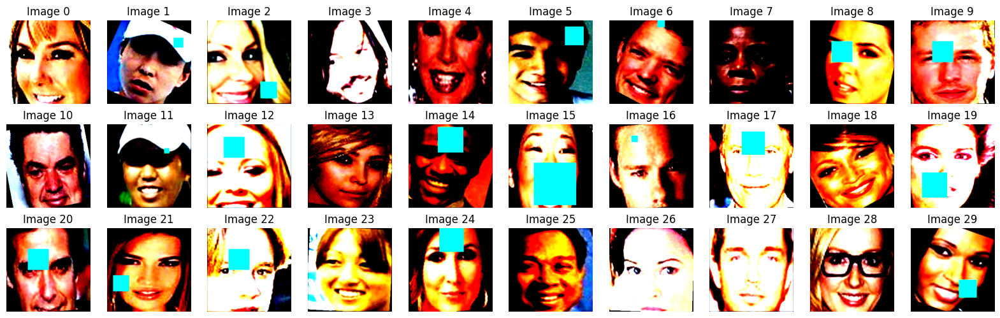

In [95]:
plt.figure(figsize=(20, 6))
for i in range(30):
    img = Image.open(f"./data_aug/img{i}.png")
    ax = plt.subplot(3, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')

### 4.2. Détails d'implémentation

Les principaux points d'intérêt de mon implémentation sont les suivants :
* Utilisation de l'optimizer SING, qui se revendique plus performant que AdamW. J'ai effectivement obtenu de meilleurs résultats avec cet optimizer, mais cela est peut-être dû à une recherche d'hyperparamètres plus performante.
* Split test train avec stratification sur le genre et la classe afin de réduire l'impact de la seed de split (`labels['stratif'] = labels['label'].astype(str) + labels['genre'].astype(str)`)
* Label Smoothing de 0.1 pour réduire l'overfitting (les labels valant 1 sont passés à 0.9 dans la loss, ceux à 0 sont passés à 0.1)
* Désactivation de la normalisation L2 (weight decay) pour les paramètres de la Batch et Layer Normalization
* Utilisation de la library `Accelerate` de HuggingFace pour faciliter l'utilisation d'optimisations telles qu'accumulation de gradients
* Utilisation de la loss `binary_cross_entropy_with_logits` de PyTorch pour améliorer la stabilité numérique des calculs

L'entièreté du code utilisé est disponible en annexe

### 4.3. Sélection du modèle à soumettre

Ci-dessous sont représentés les courbes obtenues pendant l'entraînement de mon meilleur modèle

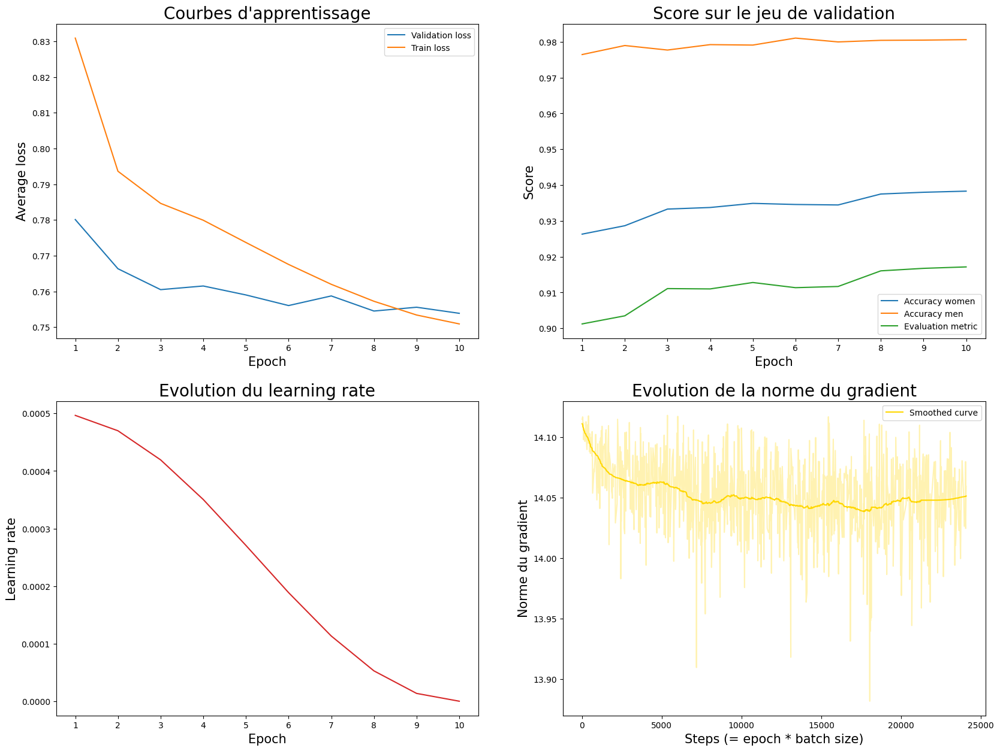

In [97]:
plt.figure(figsize=(20, 15))
val = pd.read_csv('./tensorboard/learning_curve_val.csv', sep = ',', header = 0)
train = pd.read_csv('./tensorboard/learning_curve_train.csv', sep = ',', header = 0)
acc_g0 = pd.read_csv('./tensorboard/acc_g0.csv', sep = ',', header = 0)
acc_g1 = pd.read_csv('./tensorboard/acc_g1.csv', sep = ',', header = 0)
score = pd.read_csv('./tensorboard/score.csv', sep = ',', header = 0)
learning_rate = pd.read_csv('./tensorboard/learning_rate_scheduler.csv', sep = ',', header = 0)
gradient_norm = pd.read_csv('./tensorboard/gradient_norm.csv', sep = ',', header = 0)
smooth_grad = savgol_filter(gradient_norm['Value'], 200, 3) # window size 51, polynomial order 3

ax = plt.subplot(2, 2, 1)
ax.plot(val['Step'] + 1, val['Value'], label="Validation loss")
ax.plot(train['Step'] + 1, train['Value'], label="Train loss")
ax.set_xticks(val['Step'] + 1)
ax.set_xlabel("Epoch", fontsize = 15)
ax.set_ylabel("Average loss", fontsize = 15)
ax.legend()
ax.set_title("Courbes d'apprentissage", fontsize = 20)

ax = plt.subplot(2, 2, 2)
ax.plot(acc_g0['Step'] + 1, acc_g0['Value'], label="Accuracy women")
ax.plot(acc_g1['Step'] + 1, acc_g1['Value'], label="Accuracy men")
ax.plot(score['Step'] + 1, score['Value'], label="Evaluation metric")
ax.set_xticks(score['Step'] + 1)
ax.set_xlabel("Epoch", fontsize = 15)
ax.set_ylabel("Score", fontsize = 15)
ax.legend()
ax.set_title("Score sur le jeu de validation", fontsize = 20)

ax = plt.subplot(2, 2, 3)
ax.plot(learning_rate['Step'] + 1, learning_rate['Value'], color='C3')
ax.set_xticks(learning_rate['Step'] + 1)
ax.set_xlabel("Epoch", fontsize = 15)
ax.set_ylabel("Learning rate", fontsize = 15)
ax.set_title("Evolution du learning rate", fontsize = 20)

ax = plt.subplot(2, 2, 4)
ax.plot(gradient_norm['Step'] + 1, gradient_norm['Value'], color='gold', alpha=0.3)
ax.plot(gradient_norm['Step'] + 1, smooth_grad, color='gold', label="Smoothed curve")
ax.set_xlabel("Steps (= epoch * batch size)", fontsize = 15)
ax.set_ylabel("Norme du gradient", fontsize = 15)
ax.legend()
ax.set_title("Evolution de la norme du gradient", fontsize = 20)

plt.show()

On observe sur les courbes d'apprentissage ci-dessus (graphe 1) qu'à partir de la 9ème epoch, la loss de train continue de descendre alors que la loss sur le jeu de validation stagne. Ceci est signe d'overfitting. Conjointement, on remarque sur le jeu de validation que le score de précision pour les femmes atteint un pallier à partir de l'epoch 8. J'ai donc utilisé les poids du modèle entraîné à l'epoch 8 pour obtenir mon meilleur score.<br>
La courbe du learning rate montre l'évolution du learning rate avec le scheduler cosinus. <br>
L'évolution du la norme du gradient est suivie comme recommandée par l'auteur de SING : https://github.com/AdrienCourtois/SING/tree/main#further-recommandations. La norme du gradient n'augmentant pas de manière significative, je n'ai pas eu besoin de désactiver l'apprentissage des paramètres de la LayerNorm.

## 5. Visualisation d'attention maps

### 5.1. Principe

<u>Idée</u> : S'appuyer sur les features apprises par le modèle pour raffiner notre compréhension des caractéristiques définissant les labels <br>


Le modèle DINO est particulièrement utile pour cela. En effet, ce modèle est construit sur une architecture à base de [transformer visuel (ViT)](https://arxiv.org/abs/2010.11929), qui contient donc un token \[CLS\] ne correspondant pas à un patch d'image mais servant à encoder des informations sur la classe présente dans l'image (représenté par * sur l'image ci-dessous)

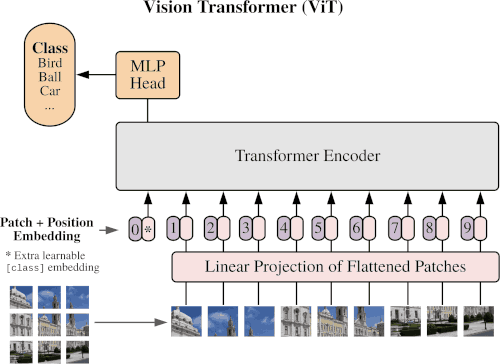

Une fois le modèle entraîné, la valeur de self-attention du token \[CLS\] retournée par la dernière couche du réseau permet donc de visualiser les zones de l'image sur lesquelles le modèle se focalise pour la classifier. Les auteurs de DINO ont remarqué que cette valeur de self-attention permet de segmenter les objets présents sur une image sans supervision (DINO est un modèle de SSL dont le but initial est uniquement d'apprendre de bonnes représentations d'images). J'ai donc adapté le code de visualisation proposé sur le [GitHub de DINO](https://github.com/facebookresearch/dino/blob/main/visualize_attention.py) pour générer des attention maps sur des images sélectionnées dans les 2 classes pour les 2 genres. <br>
Le modèle n'a pas 100% de précision, et peut classer correctement certaines images  par chance, en se basant sur des corrélation fallacieuses. Cependant, l'espoir est que le modèle soit suffisamment performant pour tout de même apporter quelques informations pertinentes sur les caractéristiques liées aux labels.

### 5.2. Sélection d'images d'intérêt

Pour récupérer des informations pertinentes, j'ai décidé de générer des attention maps principalement pour des images correctement classées par le modèle (10 pour chaque association label-genre) ainsi que pour quelques images incorrectement classifiées (2 pour chaque association label-genre). Le code permettant de récupérer les indices d'images d'intérêt est présenté ci-dessous

In [98]:
# Le fichier inspect_errors_best_model.csv contient les prédictions du modèle sur le jeu de training (train + val)
inspect = pd.read_csv('./inspect_errors_best_model.csv')
inspect = inspect.loc[:, ~inspect.columns.str.contains('^Unnamed')]
inspect['label'] = labels['label'].map(lambda x: 0 if x == -1 else x)
# Images mal classifiées par le modèle
errors = inspect.query("label != prediction")
# Images correctement classfiées par le modèle
correct = inspect.query("label == prediction")

# Récupération des indices des images correctement classifiées
# selon 4 catégories (genre 0 label -1 / genre 0 label 1 / genre 1 label -1 / genre 1 label 1)
cat1 = correct.query("label == 0 and genre == -1").index.values
cat2 = correct.query("label == 1 and genre == -1").index.values
cat3 = correct.query("label == 0 and genre == 1").index.values
cat4 = correct.query("label == 1 and genre == 1").index.values
# Récupération des indices des images mal classifiées
# selon 4 catégories (genre 0 label -1 / genre 0 label 1 / genre 1 label -1 / genre 1 label 1)
cat5 = errors.query("label == 0 and genre == -1").index.values
cat6 = errors.query("label == 1 and genre == -1").index.values
cat7 = errors.query("label == 0 and genre == 1").index.values
cat8 = errors.query("label == 1 and genre == 1").index.values

# Tire aléatoirement 10 images de chacune des 4 premières catégories
idx1 = np.random.choice(cat1, size=10)
idx2 = np.random.choice(cat2, size=10)
idx3 = np.random.choice(cat3, size=10)
idx4 = np.random.choice(cat4, size=10)
# Tire aléatoirement 2 images de chacune des 4 dernières catégories
idx5 = np.random.choice(cat5, size=2)
idx6 = np.random.choice(cat6, size=2)
idx7 = np.random.choice(cat7, size=2)
idx8 = np.random.choice(cat8, size=2)

# Les 48 indices tirés sont enregistrés et utilisés
# pour générer des attention maps à l'aide du script en annexe 6.3. 
indices = np.concatenate((idx1, idx2, idx3, idx4, idx5, idx6, idx7, idx8))
np.save("attention_maps/idx_samples.npy", indices)

### 5.3. Analyse des attention maps générées

Le modèles DINO small est constituée de 12 couches utilisant chacune **6 attention heads**. L'extraction de la self attention du token \[CLS\] de la dernière couche renvoie donc 6 features maps par image. Les 6 features maps générées pour 2 des 48 images sont représentées ci-dessous, la dernière image correspondant à la moyenne des features maps générées.

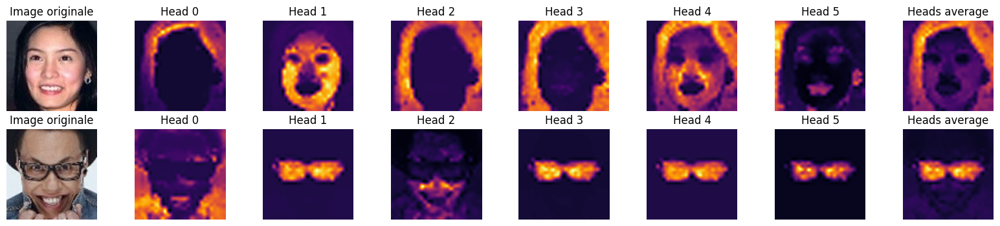

In [93]:
plt.figure(figsize=(20, 4))
img = Image.open("./attention_maps/img2.png")
ax = plt.subplot(2, 8, 1)
plt.imshow(img)
ax.set_title("Image originale")
ax.axis('off')
for i in range(6):
    img = Image.open(f"./attention_maps/img2_head{i}.png")
    ax = plt.subplot(2, 8, i + 2)
    plt.imshow(img)
    ax.set_title(f"Head {i}")
    ax.axis('off')
img = Image.open("./attention_maps/img2_heatmap.png")
ax = plt.subplot(2, 8, 8)
plt.imshow(img)
ax.set_title("Heads average")
ax.axis('off')

img = Image.open("./attention_maps/img35.png")
ax = plt.subplot(2, 8, 9)
plt.imshow(img)
ax.set_title("Image originale")
ax.axis('off')
for i in range(6):
    img = Image.open(f"./attention_maps/img35_head{i}.png")
    ax = plt.subplot(2, 8, i + 10)
    plt.imshow(img)
    ax.set_title(f"Head {i}")
    ax.axis('off')
img = Image.open("./attention_maps/img35_heatmap.png")
ax = plt.subplot(2, 8, 16)
plt.imshow(img)
ax.set_title("Heads average")
ax.axis('off')
plt.show()

Pour les personnes ne portant pas de lunettes, il est intéressant de noter que plusieurs attention heads se focalisent sur les cheveux (head 0, 2, 3 et également 4 pour la première image présentée), ce qui se voit au niveau de l'image moyennée. Ceci confirme que la couleur de cheveux est un critère très important de détermination des labels. <br>
Pour les personnes portant des lunettes, de la même manière, plusieurs attention heads se focalisent sur les lunettes, ce qui confirme également l'importance de cette caractéristique dans la détermination du label associé à une image <br>
Pour comparer plus d'images, seule la moyenne des attention head sera affichée par la suite

<u>Femmes classe -1</u>

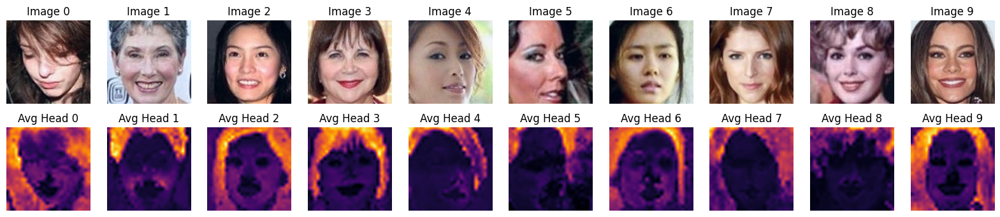

In [87]:
plt.figure(figsize=(20, 4))
for i in range(10):
    img = Image.open(f"./attention_maps/img{i}.png")
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')
    img = Image.open(f"./attention_maps/img{i}_heatmap.png")
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(img)
    ax.set_title(f"Avg Head {i}")
    ax.axis('off')

La couleur des cheveux semble être le principal facteur analysé par le modèle pour attribuer le label -1 aux femmes

<u>Femmes classe 1</u>

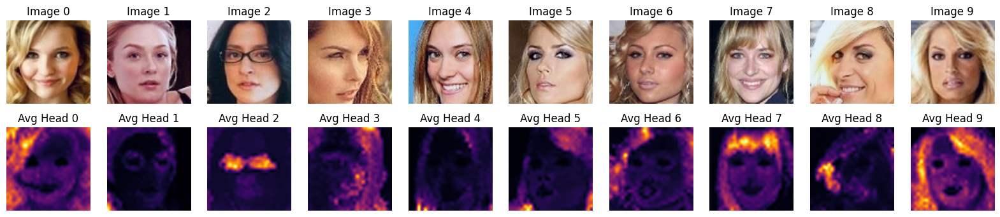

In [89]:
plt.figure(figsize=(20, 4))
for i in range(10):
    img = Image.open(f"./attention_maps/img1{i}.png")
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')
    img = Image.open(f"./attention_maps/img1{i}_heatmap.png")
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(img)
    ax.set_title(f"Avg Head {i}")
    ax.axis('off')

Pour les femmes de la classe 1, étrangement, le modèle semble se focaliser uniquement sur certaines parties des cheveux (les parties plus éclairées / plus claires). En revanche, pour les personnes avec lunettes, les cheveux ne sont pratiquement pas analysés

<u>Hommes classe -1</u>

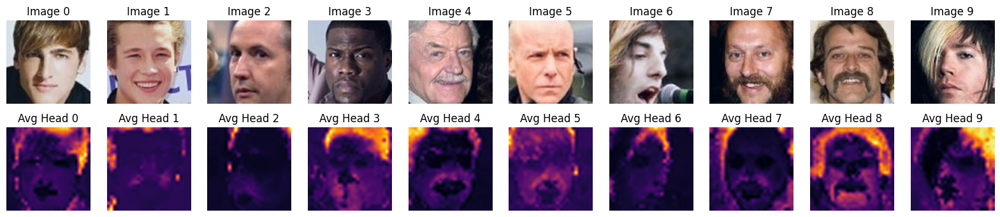

In [90]:
plt.figure(figsize=(20, 4))
for i in range(10):
    img = Image.open(f"./attention_maps/img2{i}.png")
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')
    img = Image.open(f"./attention_maps/img2{i}_heatmap.png")
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(img)
    ax.set_title(f"Avg Head {i}")
    ax.axis('off')

De la même manière que pour les femmes, les cheveux (ou leur absence) semble être le principal point d'attention du modèle pour attribuer le label -1. Pour les personnes aux cheveux bicolores (images 6 et 9), le modèle se focalise exclusivement sur les cheveux foncés / noir, ce qui semble confirmer que la couleur blonde est plutôt associée à la classe 1.

<u>Hommes classe 1</u>

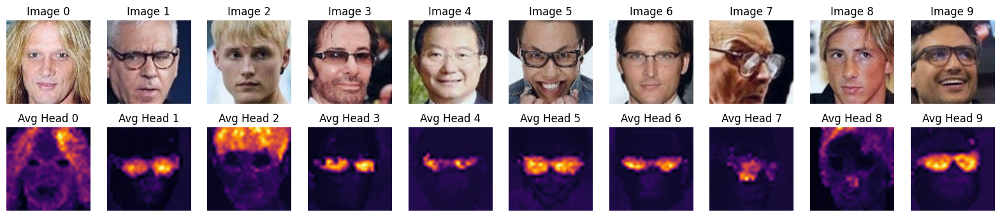

In [91]:
plt.figure(figsize=(20, 4))
for i in range(10):
    img = Image.open(f"./attention_maps/img3{i}.png")
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')
    img = Image.open(f"./attention_maps/img3{i}_heatmap.png")
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(img)
    ax.set_title(f"Avg Head {i}")
    ax.axis('off')

De même que pour les femmes, lorsqu'une personne porte des lunettes, le réseau se focalise principalement sur cet élément pour réaliser la classification. Les hommes sans lunettes appartenant à la classe 1 semblent être majoritairement blonds, ce qui est confirmé par l'attention portée par le réseau sur les cheveux de ces personnes.

<u>Erreurs de classification</u>

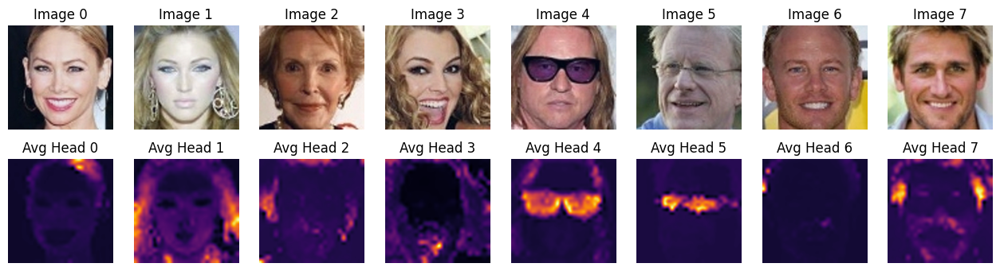

In [94]:
plt.figure(figsize=(20, 4))
for i in range(8):
    img = Image.open(f"./attention_maps/img4{i}.png")
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(img)
    ax.set_title(f"Image {i}")
    ax.axis('off')
    img = Image.open(f"./attention_maps/img4{i}_heatmap.png")
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(img)
    ax.set_title(f"Avg Head {i}")
    ax.axis('off')

Les images 0 et 1 correspondent à des femmes de la classe -1 classifiée en classe 1 par le réseau. Elles sont en effet blondes, et il semble difficile de comprendre pourquoi elles sont associées à la classe 0. <br>
Les images 2 et 3 correspondent à des femmes de la classe 1 classifiée en -1 par le modèle. Elles ont les cheveux plus foncés que les autres membres de la classe 1, l'intensité des pixels sur les cheveux n'est pas très forte, ce qui peut expliquer l'erreur de classification du réseau. <br>
Les images 4 et 5 correspondent à des hommes de la classe -1 classifiés en classe 1 par le résea. L'erreur se comprend, les 2 hommes portent des lunettes. Difficile de savoir si d'autres critères sont à prendre en considération pour la classification en classe 1, ou s'il s'agit d'une erreur de label... <br>
Les images 6 et 7 correspondent à des hommes de la classe -1 classifiés en classe 1. Ils sont en effet blonds, mais le réseau semble s'être focalisés sur les parties les plus sombres de leur chevelure pour arriver à une conclusion erronée.

Les observations initialement réalisées à partir de l'étude des images semble donc confirmée par l'analyse des attention heads générées par le modèle : la classe 1 correspond majoritairement aux personnes blondes et portant des lunettes. La présence de contre-exemples ne permet cependant pas de trancher sur la définition exacte des ces labels ... ou sur la présence d'images mal labelllisées dans le jeu de données.

## 6. Annexes

### 6.1. Script d'entraînement

In [ ]:
import logging
import os
import os.path
import pandas as pd
import numpy as np
from accelerate import Accelerator
from PIL import Image
from sklearn.model_selection import train_test_split
from sing import SING
import torch
import torch.nn as nn
from torch.utils.tensorboard import SummaryWriter
import lightning.pytorch as pl
from tqdm import tqdm
from transformers import get_cosine_schedule_with_warmup, ViTForImageClassification

from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField
from ffcv.loader import Loader, OrderOption
import ffcv.transforms as fftr
from ffcv.fields.decoders import IntDecoder, RandomResizedCropRGBImageDecoder, SimpleRGBImageDecoder


batch_size = 64
grad_acc = 1
lr = 5e-4
weight_decay = 5e-3
writer = SummaryWriter(f"./logs/Dino_sing/lr{lr}_wd{weight_decay}_bs{batch_size*grad_acc}")
workers = 8
accelerator = Accelerator(gradient_accumulation_steps=grad_acc)
torch.backends.cuda.matmul.allow_tf32 = True
torch.set_float32_matmul_precision('high')
pl.seed_everything(42, workers=True)


class IdemiaDataset():
    def __init__(self, data, img_dir, size):
        self.img_dir = img_dir
        self.data = data
        self.size = size

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name, label, genre, _ = self.data.iloc[idx]
        img_path = os.path.join(self.img_dir, img_name)
        image = Image.open(img_path)
        image = image.resize((self.size, self.size), Image.Resampling.BICUBIC)

        return image, label, genre


def get_loaders(labels, size, Imagenet=False):
    if Imagenet:
        data_mean, data_std = np.array([0.485, 0.456, 0.406]) * 255, np.array([0.229, 0.224, 0.225]) * 255
    else:
        data_mean, data_std = np.array([0.5550244450569153, 0.4250235855579376, 0.36004188656806946]) * 255, np.array([0.28600722551345825, 0.24972566962242126, 0.23863893747329712]) * 255
    data_train, data_val = train_test_split(labels, stratify=labels.stratif, test_size=0.2, random_state=35, shuffle=True)
    trainset = IdemiaDataset(data_train, "./train/", size)
    valset = IdemiaDataset(data_val, "./train/", size)

    # Convert datasets to ffcv
    file_train = f"./ffcv/train_{size}_Imagenet.beton" if Imagenet else f"./ffcv/train_{size}.beton"
    file_val = f"./ffcv/val_{size}_Imagenet.beton" if Imagenet else f"./ffcv/val_{size}.beton"
    if not os.path.isfile(file_train):
        writer_train = DatasetWriter(file_train, {
            'image': RGBImageField(write_mode='jpg', jpeg_quality=100),
            'label': IntField(),
            'genre': IntField()}, num_workers=workers)
        writer_train.from_indexed_dataset(trainset)

    if not os.path.isfile(file_val):
        writer_val = DatasetWriter(file_val, {
            'image': RGBImageField(write_mode='jpg', jpeg_quality=100),
            'label': IntField(),
            'genre': IntField()}, num_workers=workers)
        writer_val.from_indexed_dataset(valset)

    decoder = RandomResizedCropRGBImageDecoder((size, size), scale=(0.5, 1))
    decoder_val = SimpleRGBImageDecoder()
    normalize = fftr.NormalizeImage(mean=data_mean, std=data_std, type=np.float32)
    eraser_mean = list((np.random.rand(3,) * 255).astype(int))
    image_train_pipeline = [decoder, fftr.RandomHorizontalFlip(), fftr.Rotate(angle=0.5),
                            fftr.RandomErasing(erase_prob=0.5, scale=(0.02, 0.4), ratio=(0.15, 6), mean=eraser_mean),
                            fftr.RandomColorJitter(jitter_prob=0.5, brightness=[1.0, 1.5], contrast=0, saturation=[1.0, 1.5], hue=0),
                            fftr.GaussianBlur(0.5), fftr.ToTensor(), fftr.ToTorchImage(), fftr.ToDevice(accelerator.device, non_blocking=True), normalize]
    image_val_pipeline = [decoder_val, fftr.ToTensor(), fftr.ToTorchImage(), fftr.ToDevice(accelerator.device, non_blocking=True), normalize]
    label_pipeline = [IntDecoder(), fftr.ToTensor(), fftr.Convert(torch.float16), fftr.ToDevice(accelerator.device, non_blocking=True), fftr.Squeeze()]

    # Pipeline for each data field
    pipeline_train = {
        'image': image_train_pipeline, 'label': label_pipeline, 'genre': label_pipeline
    }
    pipeline_val = {
        'image': image_val_pipeline, 'label': label_pipeline, 'genre': label_pipeline
    }

    trainloader = Loader(file_train, batch_size=batch_size, num_workers=workers,
                         order=OrderOption.RANDOM, pipelines=pipeline_train)
    valloader = Loader(file_val, batch_size=batch_size, num_workers=workers,
                       order=OrderOption.SEQUENTIAL, pipelines=pipeline_val)

    return trainloader, valloader


def evaluate(model, valloader):
    valloader = tqdm(valloader, leave=False)
    with torch.no_grad():
        loss, count, global_acc = 0, 0, 0
        acc_g0, acc_g1, count_g0, count_g1 = 0, 0, 0, 0
        for batch in valloader:
            X_val, y_val, genre = batch
            count += X_val.shape[0]
            count_g0 += torch.sum(genre == -1)
            count_g1 += torch.sum(genre == 1)
            mask0 = (genre == -1).nonzero(as_tuple=True)[0]
            mask1 = (genre == 1).nonzero(as_tuple=True)[0]
            output = model(X_val).logits
            y_smoothed = torch.where(nn.functional.one_hot(y_val.long(), num_classes=2) == 1, 0.9, 0.1)
            loss += nn.functional.binary_cross_entropy_with_logits(output, y_smoothed, reduction="sum")
            y_pred = torch.argmax(output, dim=1)
            global_acc += torch.sum(y_pred == y_val)
            acc_g0 += torch.sum(y_pred[mask0] == y_val[mask0])
            acc_g1 += torch.sum(y_pred[mask1] == y_val[mask1])
            valloader.set_description(f"Val Loss: {loss/count:.4f} - Val acc: {global_acc/count:.4f} - Acc g0: {acc_g0/count_g0:.4f} - Acc g1: {acc_g1/count_g1:.4f}")
        acc_g0, acc_g1 = acc_g0 / count_g0, acc_g1 / count_g1
        score = 0.5 * (acc_g0 + acc_g1) - abs(acc_g0 - acc_g1)

    return loss / count, global_acc / count, acc_g0, acc_g1, score


def train(epoch, trainloader, valloader, model, optimizer, scheduler):
    epochs = tqdm(range(epoch))
    best_acc = 0
    for e in epochs:
        model.train()
        losses, count = 0, 0
        trainloader = tqdm(trainloader, leave=False)
        for idx, batch in enumerate(trainloader):
            with accelerator.accumulate(model):
                X, y, _ = batch
                count += X.shape[0]
                y_pred = model(X).logits
                y_smoothed = torch.where(nn.functional.one_hot(y.long(), num_classes=2) == 1, 0.9, 0.1)
                loss = nn.functional.binary_cross_entropy_with_logits(y_pred, y_smoothed, reduction="sum")
                losses += loss.item()
                accelerator.backward(loss)
                optimizer.step()
                scheduler.step()
                grads = [param.grad.detach().flatten() for param in model.parameters() if param.grad is not None]
                norm = torch.cat(grads).norm()
                optimizer.zero_grad()
                # Observe evolution of gradient norm at each step
                writer.add_scalar('Dino_sing/gradient_norm', norm, idx + e * len(trainloader) // grad_acc)
                trainloader.set_description(f"Train Iter: {idx+1}/{len(trainloader)} - LR: {scheduler.get_last_lr()[0]:e} - Gradient norm: {norm:e} - Total Loss: {losses/count:.4f}")

        model.eval()
        valloss, valacc, acc_g0, acc_g1, score = evaluate(model, valloader)
        epochs.set_description(f"Epoch: {e+1}/{epoch} - Train Loss: {losses/count:.4f} - Val loss: {valloss:.4f} - Val accuracy: {valacc:.4f} - Acc g0:{acc_g0:.4f} - Acc g1:{acc_g1:.4f} - Val score: {score:.4f}")
        writer.add_scalars('Dino_sing/learning_curves', {'train': losses / count, 'val': valloss}, e)
        writer.add_scalar('Dino_sing/learning_rate', scheduler.get_last_lr()[0], e)
        writer.add_scalars('Dino_sing/score', {'acc_g0': acc_g0, 'acc_g1': acc_g1, 'score': score}, e)
        if valacc > best_acc:
            best_acc = valacc
        torch.save({'epoch': e + 1, 'state_dict': model.state_dict(), 'score': score, 'accuracy': valacc,
                    'optimizer': optimizer.state_dict(), 'scheduler': scheduler.state_dict()},
                    f"./results/Dino_sing/lr{lr}_wd{weight_decay}_bs{batch_size*grad_acc}_epoch{e}.pth")
    return best_acc


def main():
    logging.basicConfig(style='{', format='{asctime} : {message}', datefmt="%c", level=logging.WARNING)
    labels = pd.read_csv('./train.txt', sep='\t', header=None, names=['image', 'label', 'genre'])
    labels['label'] = labels['label'].map(lambda x: 0 if x == -1 else x)
    # Brutal hack : https://stackoverflow.com/a/51525992
    labels['stratif'] = labels['label'].astype(str) + labels['genre'].astype(str)
    trainloader, valloader = get_loaders(labels, 224, Imagenet=True)

    epoch = 10
    model = ViTForImageClassification.from_pretrained('facebook/dino-vits8', num_labels=2,
                                                      cache_dir="dino-vits8/", ignore_mismatched_sizes=True)
    no_decay_list = ["bias", "bn", "norm", "layernorm"]
    decay = [param for name, param in model.named_parameters() if not any(word in name for word in no_decay_list)]
    no_decay = [param for name, param in model.named_parameters() if any(word in name for word in no_decay_list)]
    parameters = [{"params": decay, "weight_decay": weight_decay}, {"params": no_decay, "weight_decay": 0.0}]
    optim = SING(parameters, lr=lr)
    scheduler = get_cosine_schedule_with_warmup(optim, 0.05 * len(trainloader) * epoch / grad_acc, len(trainloader) * epoch / grad_acc)
    model, optim, scheduler = accelerator.prepare(model, optim, scheduler)
    # Juste in case : https://github.com/AdrienCourtois/SING/tree/main#further-recommandations
    # for module in model.modules():
    #     if isinstance(module, nn.LayerNorm):
    #         module.weight.requires_grad_(False)
    #         module.bias.requires_grad_(False)
    best_acc = train(epoch, trainloader, valloader, model, optim, scheduler)
    print(f"Best accuracy on the validation set: {best_acc}")


if __name__ == "__main__":
    main()

### 6.2. Script d'inférence

In [ ]:
import logging
import os
from accelerate import Accelerator
import pandas as pd
import numpy as np
from PIL import Image
import torch
from transformers import ViTForImageClassification
from tqdm import tqdm
import lightning.pytorch as pl

from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField
from ffcv.loader import Loader, OrderOption
import ffcv.transforms as fftr
from ffcv.fields.decoders import IntDecoder, SimpleRGBImageDecoder


batch_size = 1
grad_acc = 1
workers = 8
accelerator = Accelerator(gradient_accumulation_steps=grad_acc)
torch.backends.cuda.matmul.allow_tf32 = True
torch.set_float32_matmul_precision('high')
pl.seed_everything(42, workers=True)


class IdemiaDataset():
    def __init__(self, data, img_dir, size):
        self.img_dir = img_dir
        self.data = data
        self.size = size

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name, label, genre, _ = self.data.iloc[idx]
        img_path = os.path.join(self.img_dir, img_name)
        image = Image.open(img_path)
        image = image.resize((self.size, self.size), Image.Resampling.BICUBIC)

        return image, label, genre


class TestDataset():
    def __init__(self, img_dir, size):
        self.img_dir = img_dir
        self.size = size

    def __len__(self):
        return 9999

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, f"{idx:06}.jpg")
        image = Image.open(img_path)
        image = image.resize((self.size, self.size), Image.Resampling.BICUBIC)

        return image, idx


def get_loaders(size, Imagenet=False):
    if Imagenet:
        data_mean, data_std = np.array([0.485, 0.456, 0.406]) * 255, np.array([0.229, 0.224, 0.225]) * 255
    else:
        data_mean, data_std = np.array([0.5550244450569153, 0.4250235855579376, 0.36004188656806946]) * 255, np.array([0.28600722551345825, 0.24972566962242126, 0.23863893747329712]) * 255
    testet = TestDataset("./test/", size)

    # Convert datasets to ffcv
    file_test = f"./ffcv/test_{size}_Imagenet.beton" if Imagenet else f"./ffcv/test_{size}.beton"
    if not os.path.isfile(file_test):
        writer_test = DatasetWriter(file_test,
                                    {'image': RGBImageField(write_mode='jpg', jpeg_quality=100),
                                    'label': IntField()}, num_workers=workers)
        writer_test.from_indexed_dataset(testet)

    decoder = SimpleRGBImageDecoder()
    normalize = fftr.NormalizeImage(mean=data_mean, std=data_std, type=np.float32)
    image_test_pipeline = [decoder, fftr.ToTensor(), fftr.ToTorchImage(), fftr.ToDevice(accelerator.device, non_blocking=False), normalize]
    label_pipeline = [IntDecoder(), fftr.ToTensor(), fftr.Convert(torch.float16), fftr.ToDevice(accelerator.device, non_blocking=False)]
    
    # Pipeline for each data field
    pipeline_test = {'image': image_test_pipeline, 'label': label_pipeline}
    testloader = Loader(file_test, batch_size=batch_size, num_workers=workers,
                        order=OrderOption.SEQUENTIAL, pipelines=pipeline_test, drop_last=False)

    return testloader


def predict(model, dataloader):
    dataloader = tqdm(dataloader, leave=False)
    y_pred = []
    with torch.no_grad():
        for batch in dataloader:
            X, _ = batch
            output = model(X).logits
            y_pred.extend(torch.argmax(output, dim=1).int().tolist())
    return y_pred


def main():
    logging.basicConfig(style='{', format='{asctime} : {message}', datefmt="%c", level=logging.INFO)
    testloader = get_loaders(224, Imagenet=True)
    model = ViTForImageClassification.from_pretrained('facebook/dino-vits8', num_labels=2,
                                                      cache_dir="dino-vits8/", ignore_mismatched_sizes=True)
    checkpoint = torch.load("results/Dino_sing/best_model.pth")
    # Rename keys of saved model (named changed by acceleator wrapper)
    # https://huggingface.co/docs/accelerate/package_reference/accelerator#saving-and-loading would have been more efficient
    state_dict = {}
    for k, v in checkpoint['state_dict'].items():
        state_dict[k[10:]] = v
    model.load_state_dict(state_dict)

    model, testloader = accelerator.prepare(model, testloader)
    model.eval()
    y_pred = predict(model, testloader)
    print(len(y_pred))
    print(y_pred[:10])
    results=pd.DataFrame(y_pred, columns= ['score'])
    results['score'] = results['score'].map(lambda x: -1 if x == 0 else 1)
    results.to_csv(f"prediction_Dino_sing_best_model.csv", header = None, index = None)


if __name__ == "__main__":
    main()

### 6.3. Génération des attention maps

In [ ]:
import logging
import os
from accelerate import Accelerator
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torch
import torchvision
from transformers import ViTForImageClassification
from tqdm import tqdm
import lightning.pytorch as pl

from ffcv.writer import DatasetWriter
from ffcv.fields import RGBImageField, IntField
from ffcv.loader import Loader, OrderOption
import ffcv.transforms as fftr
from ffcv.fields.decoders import IntDecoder, SimpleRGBImageDecoder


grad_acc = 1
workers = 8
accelerator = Accelerator(gradient_accumulation_steps=grad_acc)
torch.backends.cuda.matmul.allow_tf32 = True
torch.set_float32_matmul_precision('high')
pl.seed_everything(42, workers=True)


class IdemiaDataset():
    def __init__(self, data, img_dir, size):
        self.img_dir = img_dir
        self.data = data
        self.size = size

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name, _, _ = self.data.iloc[idx]
        img_path = os.path.join(self.img_dir, img_name)
        image = Image.open(img_path)
        image = image.resize((self.size, self.size), Image.Resampling.BICUBIC)

        return image, idx


def get_loaders(data, size, Imagenet=False):
    if Imagenet:
        data_mean, data_std = np.array([0.485, 0.456, 0.406]) * 255, np.array([0.229, 0.224, 0.225]) * 255
    else:
        data_mean, data_std = np.array([0.5550244450569153, 0.4250235855579376, 0.36004188656806946]) * 255, np.array([0.28600722551345825, 0.24972566962242126, 0.23863893747329712]) * 255
    dataset = IdemiaDataset(data, "./train/", size)

    # Convert datasets to ffcv
    file = f"./ffcv/sample_{size}_Imagenet.beton" if Imagenet else f"./ffcv/sample_{size}.beton"
    writer_test = DatasetWriter(file,
                                {'image': RGBImageField(write_mode='jpg', jpeg_quality=100),
                                'label': IntField()}, num_workers=workers)
    writer_test.from_indexed_dataset(dataset)

    decoder = SimpleRGBImageDecoder()
    normalize = fftr.NormalizeImage(mean=data_mean, std=data_std, type=np.float32)
    image_test_pipeline = [decoder, fftr.ToTensor(), fftr.ToTorchImage(), fftr.ToDevice(accelerator.device, non_blocking=False), normalize]
    label_pipeline = [IntDecoder(), fftr.ToTensor(), fftr.Convert(torch.float16), fftr.ToDevice(accelerator.device, non_blocking=False)]

    # Pipeline for each data field
    pipeline_test = {'image': image_test_pipeline, 'label': label_pipeline}
    dataloader = Loader(file, batch_size=len(data), num_workers=workers,
                        order=OrderOption.SEQUENTIAL, pipelines=pipeline_test, drop_last=False)

    return dataloader


def main():
    logging.basicConfig(style='{', format='{asctime} : {message}', datefmt="%c", level=logging.INFO)
    labels = pd.read_csv('./train.txt', sep='\t', header=None, names=['image', 'label', 'genre'])
    labels['label'] = labels['label'].map(lambda x: 0 if x == -1 else x)
    samples = np.load("attention_maps/idx_samples.npy")
    data = labels.iloc[samples]
    dataloader = get_loaders(data, 224, Imagenet=True)
    model = ViTForImageClassification.from_pretrained('facebook/dino-vits8', num_labels=2,
                                                      cache_dir="dino-vits8/", ignore_mismatched_sizes=True)
    checkpoint = torch.load("results/Dino_sing/best_model.pth")
    # Rename keys of saved model (named changed by acceleator wrapper)
    # https://huggingface.co/docs/accelerate/package_reference/accelerator#saving-and-loading would have been more efficient
    state_dict = {}
    for k, v in checkpoint['state_dict'].items():
        state_dict[k[10:]] = v
    model.load_state_dict(state_dict)
    model, dataloader = accelerator.prepare(model, dataloader)
    model.eval()
    
    for batch in dataloader:
        X, _ = batch
    outputs = model(X, output_attentions=True)
    last_attention = outputs.attentions[-1]
    # https://github.com/facebookresearch/dino/blob/main/visualize_attention.py -> récupère les nh attention maps pour UNE SEULE image
    # Dimension de l'image divisée par taille de patch (vits8 dans notre cas, donc patch_size = 8)
    featmap_dim = 224 // 8
    # Number of heads
    nh = last_attention.shape[1]
    for i, attention in enumerate(tqdm(last_attention)):
        # We only keep the output patch attention
        attention = attention[:, 0, 1:].reshape(nh, featmap_dim, featmap_dim)
        attention = torch.nn.functional.interpolate(attention.unsqueeze(0), scale_factor=8, mode="bicubic")[0].cpu().detach().numpy()
        torchvision.utils.save_image(torchvision.utils.make_grid(X[i].cpu().detach(), normalize=True, scale_each=True),
                                     os.path.join("attention_maps", f"img{i}.png"))
        attention_mean = []
        for j in range(nh):
            fname = os.path.join("attention_maps", f"img{i}_head{j}.png")
            attention_mean.append(attention[j])
            plt.imsave(fname=fname, arr=attention[j], format='png', cmap="inferno")
        attention_mean = np.stack(attention_mean)
        fname = os.path.join("attention_maps", f"img{i}_heatmap.png")
        plt.imsave(fname=fname, arr=np.mean(attention_mean, axis=0), format='png', cmap="inferno")


if __name__ == "__main__":
    main()